In [1]:
#https://towardsdatascience.com/audio-classification-with-pre-trained-vgg-19-keras-bca55c2a0efe
#https://towardsdatascience.com/music-genre-classification-with-python-c714d032f0d8

In [2]:
from pydub import AudioSegment
from scipy.io.wavfile import read
import librosa
import IPython.display as ipd
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
import numpy as np
import os
import sklearn
import csv
import youtube_dl
import pandas as pd
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split
import keras
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
# import pyaudio

# PyDUB

In [3]:
sound = AudioSegment.from_mp3('Dataset/TringTring/1.mp3')
sound.export("Dataset/TringTring/1.wav", format="wav")

<_io.BufferedRandom name='Dataset/TringTring/1.wav'>

In [4]:
audio = read("Dataset/TringTring/1.wav")

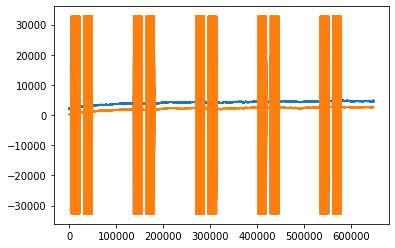

In [5]:
plt.plot(audio[1])

# Librosa

In [6]:
audio_path_base = 'Dataset/TringTring'
audio_paths = []
files = os.listdir(audio_path_base)
files.remove('.ipynb_checkpoints')
for path in files:
    audio_paths.append(os.path.join(audio_path_base, path))
audio_paths

['Dataset/TringTring/7.mp3',
 'Dataset/TringTring/6.mp3',
 'Dataset/TringTring/4.mp3',
 'Dataset/TringTring/5.mp3',
 'Dataset/TringTring/.DS_Store',
 'Dataset/TringTring/1.mp3',
 'Dataset/TringTring/2.mp3',
 'Dataset/TringTring/3.mp3',
 'Dataset/TringTring/21.mp3',
 'Dataset/TringTring/20.mp3',
 'Dataset/TringTring/18.mp3',
 'Dataset/TringTring/19.mp3',
 'Dataset/TringTring/17.mp3',
 'Dataset/TringTring/16.mp3',
 'Dataset/TringTring/14.mp3',
 'Dataset/TringTring/15.mp3',
 'Dataset/TringTring/11.mp3',
 'Dataset/TringTring/10.mp3',
 'Dataset/TringTring/1.wav',
 'Dataset/TringTring/12.mp3',
 'Dataset/TringTring/13.mp3',
 'Dataset/TringTring/23.wav',
 'Dataset/TringTring/22.wav',
 'Dataset/TringTring/8.mp3',
 'Dataset/TringTring/9.mp3']

In [7]:
x , sr = librosa.load(audio_paths[11], sr=44100)

/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


In [8]:
print(type(x), type(sr))

<class 'numpy.ndarray'> <class 'int'>


In [9]:
print(x.shape, sr)

(669067,) 44100


In [10]:
#librosa.load(audio_path, sr=44100)
#librosa.load(audio_path, sr=None)

In [14]:
ipd.Audio(audio_paths[11])


## Waveform

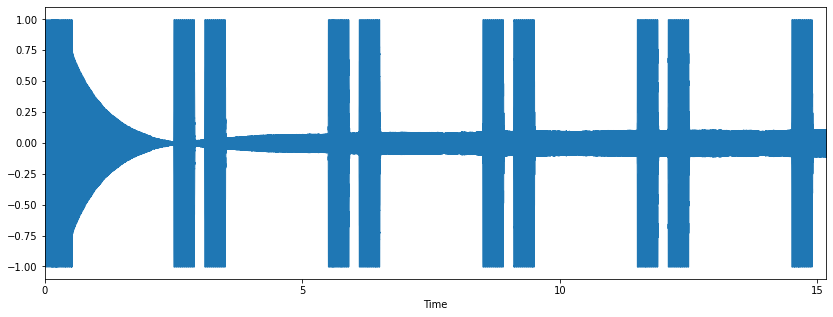

In [15]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)

## Spectogram

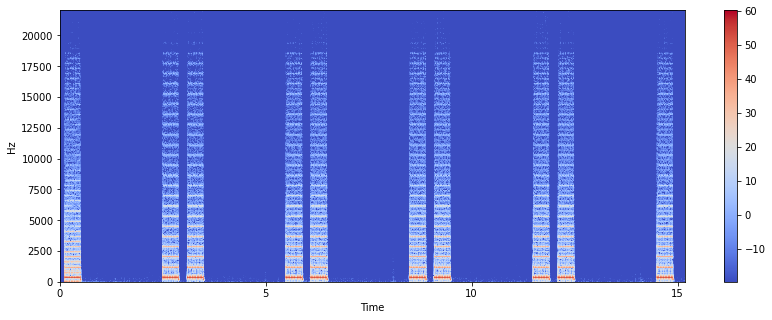

In [16]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

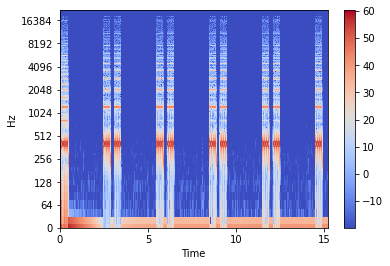

In [17]:
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

## Writing Wav

In [119]:
#librosa.output.write_wav('Dataset/Experiments/tringtring1.wav', x, sr)
#ipd.Audio('Dataset/Experiments/tringtring1.wav')

## Creating audio signal

In [120]:
# sr = 22050 # sample rate
# T = 5.0    # seconds
# t = np.linspace(0, T, int(T*sr), endpoint=False) # time variable
# x = 0.5*np.sin(2*np.pi*220*t)# pure sine wave at 220 Hz
# # Playing the audio
# ipd.Audio(x, rate=sr) # load a NumPy array

In [121]:
# Saving the audio
librosa.output.write_wav('Dataset/Experiments/tone_220.wav', x, sr)

## Zero crossing rate

/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


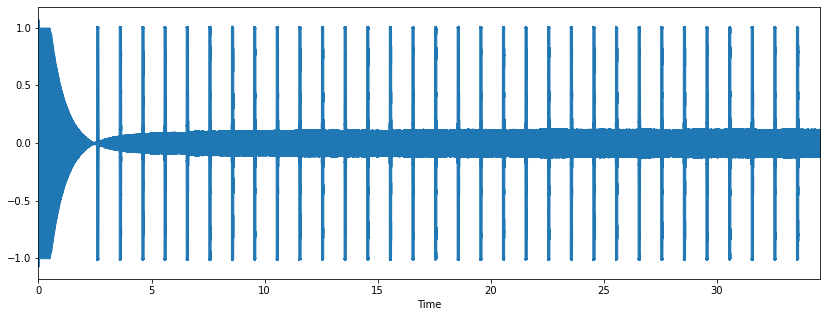

In [162]:
# Load the signal
x, sr = librosa.load(audio_paths[11])
#Plot the signal:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)

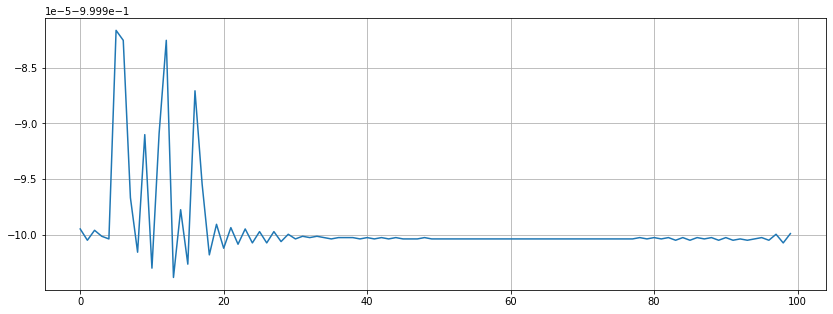

In [163]:
# Zooming in
n0 = 9000
n1 = 9100
plt.figure(figsize=(14, 5))
plt.plot(x[n0:n1])
plt.grid()

In [165]:
zero_crossings = librosa.zero_crossings(x[n0:n1], pad=False)
print(sum(zero_crossings))

0


## Spectral centroids

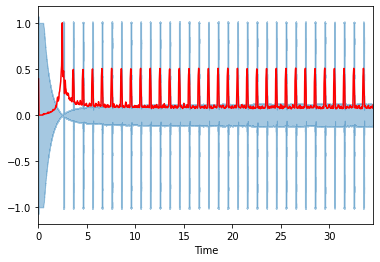

In [166]:
spectral_centroids = librosa.feature.spectral_centroid(x, sr=sr)[0]
spectral_centroids.shape
(775,)
# Computing the time variable for visualization
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
# Normalising the spectral centroid for visualisation
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)
#Plotting the Spectral Centroid along the waveform
librosa.display.waveplot(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='r')

In [169]:
np.mean(spectral_centroids)

412.6502642068184

## Spectral rolloff

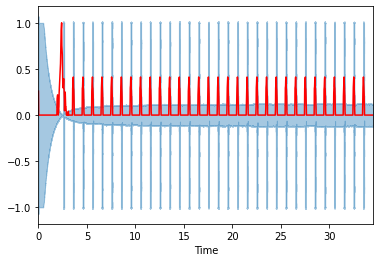

In [171]:
spectral_rolloff = librosa.feature.spectral_rolloff(x+0.01, sr=sr)[0]
librosa.display.waveplot(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

## Mel-Frequency Cepstral Coefficients

/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


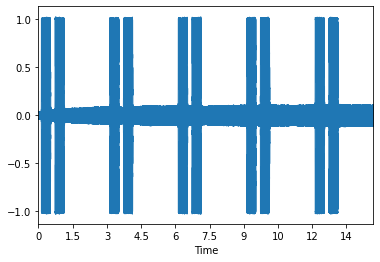

In [128]:
x, fs = librosa.load(audio_path)
librosa.display.waveplot(x, sr=sr)

(20, 633)


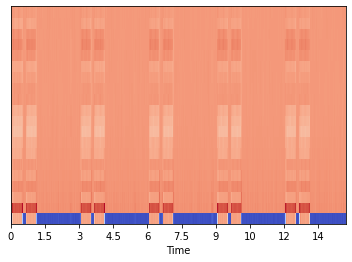

In [129]:
mfccs = librosa.feature.mfcc(x, sr=fs)
print (mfccs.shape)
(20, 97)
#Displaying  the MFCCs:
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

[ 2.4105512e-08  6.0263781e-09  0.0000000e+00 -9.0395673e-09
 -1.2052756e-08  0.0000000e+00  0.0000000e+00  1.2052756e-08
  0.0000000e+00  6.0263781e-09 -1.2052756e-08  0.0000000e+00
 -1.5065945e-09  0.0000000e+00 -1.8079135e-08 -6.0263781e-09
 -6.0263781e-09  3.0131890e-09  0.0000000e+00  0.0000000e+00]
[1.        0.9999999 1.        1.        1.        1.        1.
 1.0000001 0.9999999 1.        1.        1.        0.9999999 0.9999999
 1.        0.9999999 1.        0.9999999 1.0000001 1.0000001]


/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/sklearn/preprocessing/_data.py:173: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn("Numerical issues were encountered "
/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/sklearn/preprocessing/_data.py:190: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn("Numerical issues were encountered "


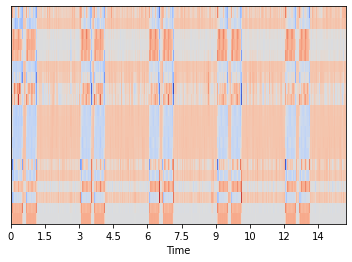

In [130]:
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
print(mfccs.mean(axis=1))
print(mfccs.var(axis=1))
var = librosa.display.specshow(mfccs, sr=sr, x_axis='time')

## Chroma Frequencies

/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


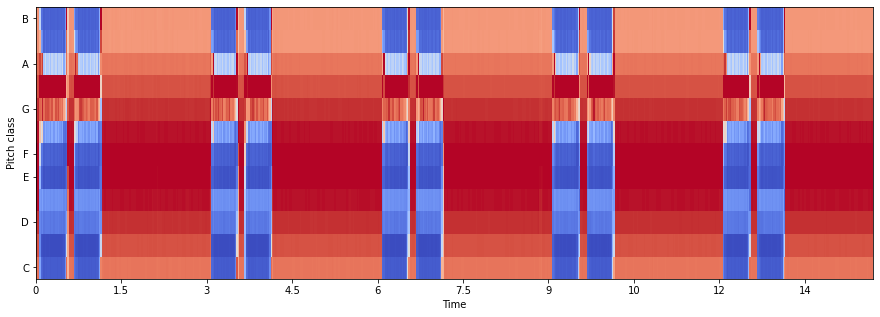

In [131]:
# Loadign the file
x, sr = librosa.load(audio_path)
hop_length = 512
chromagram = librosa.feature.chroma_stft(x, sr=sr, hop_length=hop_length)
plt.figure(figsize=(15, 5))
librosa.display.specshow(chromagram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='coolwarm')

In [140]:
len(mfccs)

20

# Feature extraction for all Tring Tring

## Saving in CSV

In [6]:
audio_path_base = '../Dataset/TringTring'
audio_paths = []
files = os.listdir(audio_path_base)
files.remove('.ipynb_checkpoints')
for path in files:
    audio_paths.append(os.path.join(audio_path_base, path))
audio_paths.remove('../Dataset/TringTring/.DS_Store')
audio_paths

['../Dataset/TringTring/7.mp3',
 '../Dataset/TringTring/6.mp3',
 '../Dataset/TringTring/4.mp3',
 '../Dataset/TringTring/5.mp3',
 '../Dataset/TringTring/1.mp3',
 '../Dataset/TringTring/2.mp3',
 '../Dataset/TringTring/3.mp3',
 '../Dataset/TringTring/21.mp3',
 '../Dataset/TringTring/20.mp3',
 '../Dataset/TringTring/18.mp3',
 '../Dataset/TringTring/19.mp3',
 '../Dataset/TringTring/17.mp3',
 '../Dataset/TringTring/16.mp3',
 '../Dataset/TringTring/14.mp3',
 '../Dataset/TringTring/15.mp3',
 '../Dataset/TringTring/11.mp3',
 '../Dataset/TringTring/10.mp3',
 '../Dataset/TringTring/1.wav',
 '../Dataset/TringTring/12.mp3',
 '../Dataset/TringTring/13.mp3',
 '../Dataset/TringTring/23.wav',
 '../Dataset/TringTring/22.wav',
 '../Dataset/TringTring/8.mp3',
 '../Dataset/TringTring/9.mp3']

In [8]:
header = 'filename chroma_stft chroma_cqt chroma_cens rmse spectral_centroid spectral_bandwidth spectral_contrast spectral_flatness rolloff zero_crossing_rate polynomial_coefficients tonnetz tempo fourier_tempo'
for i in range(1, 21):
    header += f' mfcc{i}'
header += ' label'
header = header.split()

# columns = ['filename',
#  'chroma_stft',
#  'chroma_cqt',
#  'chroma_cens',
#  'rmse',
#  'spectral_centroid',
#  'spectral_bandwidth',
#  'spectral_contrast',
#  'spectral_flatness',
#  'rolloff',
#  'zero_crossing_rate',
#  'polynomial_coefficients',
#  'tonnetz']
tring_df = pd.DataFrame(columns=header)

# file = open('TringTring.csv', 'w', newline='')
# with file:
#     writer = csv.writer(file)
#     writer.writerow(header)
    

for index, filename in enumerate(audio_paths):
    songname = filename
    y, sr = librosa.load(songname)
    chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)
    chroma_cqt = librosa.feature.chroma_cqt(y=y, sr=sr)
    chroma_cens = librosa.feature.chroma_cens(y=y, sr=sr)
    spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr)
    spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
    spec_cont = librosa.feature.spectral_contrast(y=y, sr=sr)
    spec_flat = librosa.feature.spectral_flatness(y=y)
    rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
    zcr = librosa.feature.zero_crossing_rate(y)
    mfcc = librosa.feature.mfcc(y=y, sr=sr)
    rms = librosa.feature.rms(y=y)
    poly = librosa.feature.poly_features(y=y,sr=sr)
    tonnetz = librosa.feature.tonnetz(y=y,sr=sr)
    tempo = librosa.feature.tempogram(y, sr=sr)
    fourier_tempo = librosa.feature.fourier_tempogram(y = y, sr = sr)
    to_append = f'{filename} {np.mean(chroma_stft)} {np.mean(chroma_cqt)} {np.mean(chroma_cens)} {np.mean(rms)} {np.mean(spec_cent)} {np.mean(spec_bw)} {np.mean(spec_cont)} {np.mean(spec_flat)} {np.mean(rolloff)} {np.mean(zcr)} {np.mean(poly)} {np.mean(tonnetz)} {np.mean(tempo)} {np.mean(fourier_tempo)}'    
    for e in mfcc:
        to_append += f' {np.mean(e)}'
    to_append += f' TringTring'
    tring_df.loc[index] = to_append.split()
    
#     file = open('TringTring.csv', 'a', newline='')
#     with file:
#         writer = csv.writer(file)
#         writer.writerow(to_append.split())

/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')
/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')
/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')
/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')
/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn

In [9]:
tring_df.to_csv('../training_data_csv/TringTring.csv', index=False)

## Getting conversation data with Music

In [32]:
audio_path_base_conv = 'Dataset/CallWithMusic'
audio_paths_conv = []
for path in os.listdir(audio_path_base_conv):
    audio_paths_conv.append(os.path.join(audio_path_base_conv, path))
audio_paths_conv

['Dataset/CallWithMusic/music.wav', 'Dataset/CallWithMusic/music1.wav']

In [33]:
x , sr = librosa.load(audio_paths_conv[0], sr=44100)

ipd.Audio(audio_paths_conv[0])

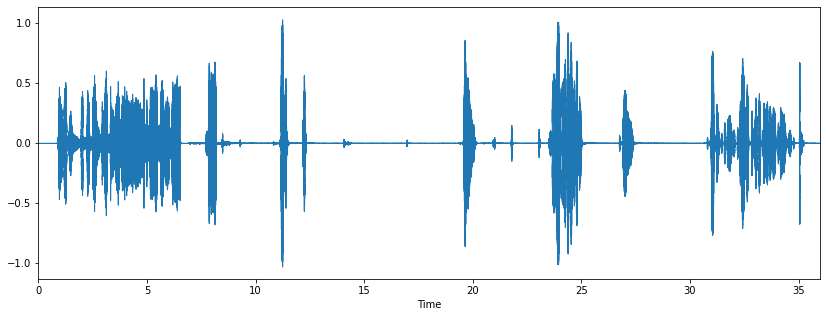

In [207]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)

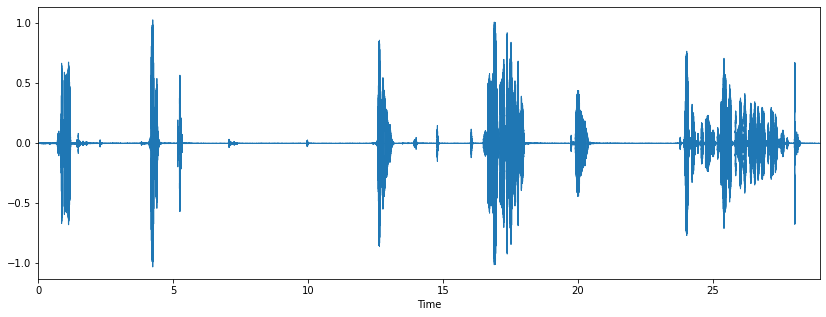

In [208]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x[7*44100:,], sr=sr)

In [210]:
librosa.output.write_wav('Dataset/ConversationWithoutTune/1.wav', x[7*44100:,], sr)

In [213]:
x , sr = librosa.load(audio_paths_conv[1], sr=44100)

ipd.Audio(audio_paths_conv[1])

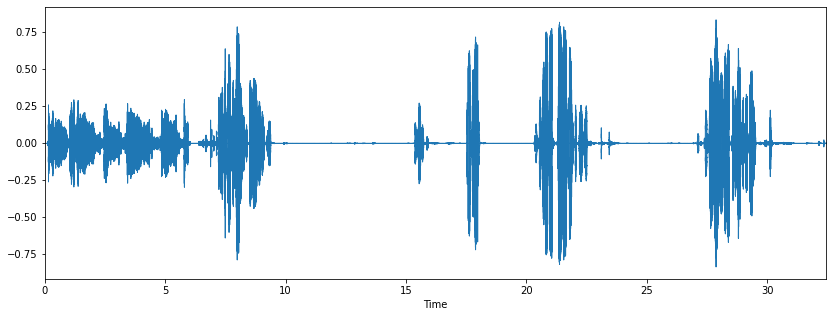

In [214]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)

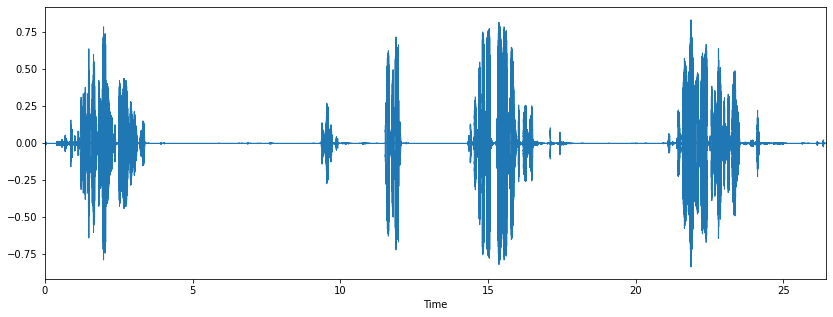

In [216]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x[6*44100:,], sr=sr)

In [217]:
librosa.output.write_wav('Dataset/ConversationWithoutTune/2.wav', x[6*44100:,], sr)

## Getting Converstaion data with Tring Tring

In [249]:
audio_path_base_conv = 'Dataset/CallWithoutMusic'
audio_paths_conv = []
for path in os.listdir(audio_path_base_conv):
    audio_paths_conv.append(os.path.join(audio_path_base_conv, path))
audio_paths_conv

['Dataset/CallWithoutMusic/tring tring.wav',
 'Dataset/CallWithoutMusic/tring tring1.wav']

In [250]:
x , sr = librosa.load(audio_paths_conv[0], sr=44100)

ipd.Audio(audio_paths_conv[0])

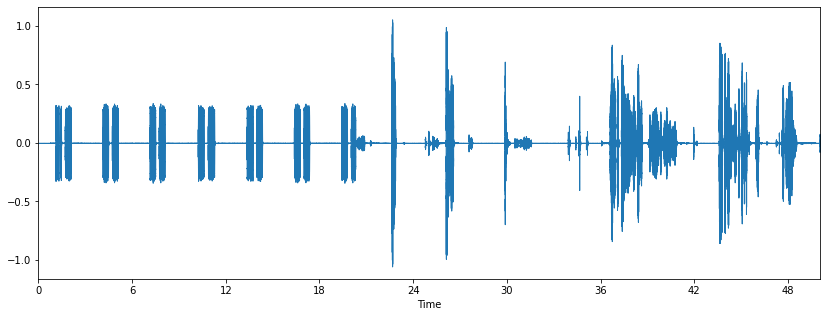

In [251]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)

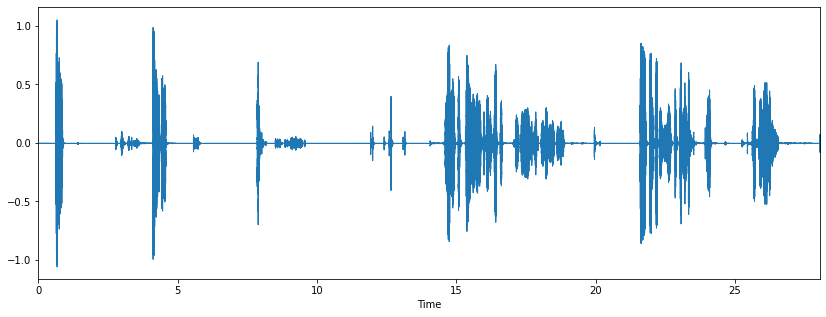

In [252]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x[22*44100:,], sr=sr)

In [253]:
librosa.output.write_wav('Dataset/ConversationWithoutTune/3.wav', x[22*44100:,], sr)
librosa.output.write_wav('Dataset/TringTring/15.wav', x[:22*44100,], sr)

In [254]:
x , sr = librosa.load(audio_paths_conv[1], sr=44100)

ipd.Audio(audio_paths_conv[])

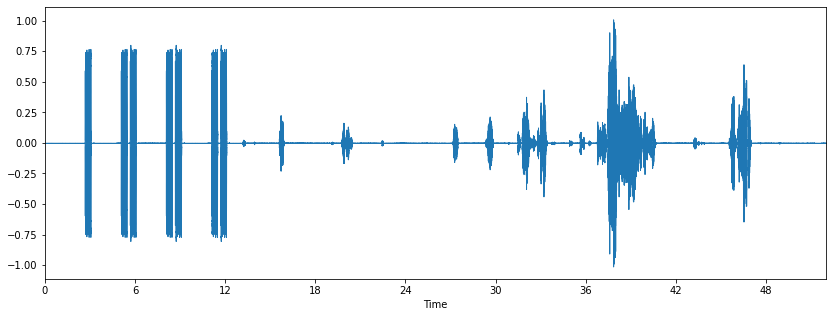

In [255]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)

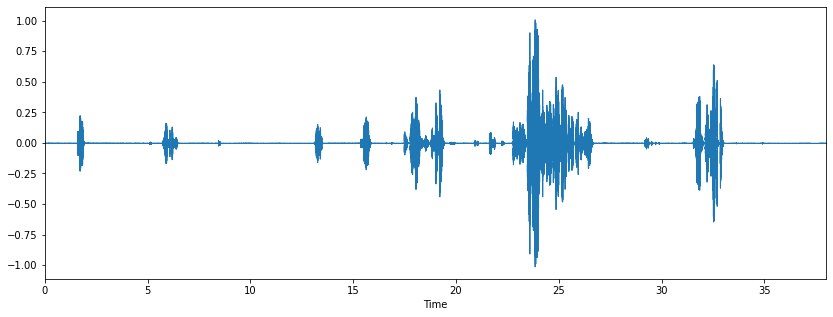

In [256]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x[14*44100:,], sr=sr)

In [257]:
librosa.output.write_wav('Dataset/ConversationWithoutTune/4.wav', x[14*44100:,], sr)
librosa.output.write_wav('Dataset/TringTring/16.wav', x[:14*44100,], sr)

## Splitting conversation data to create more data

In [261]:
base_path = 'Dataset/ConversationWithoutTune'
for file in os.listdir(base_path):
    x , sr = librosa.load(os.path.join(base_path, file), sr=44100)
    file_len = len(x)
    # Split in 3 parts:
    split_len = int(file_len/3)
    print(split_len)
    # First part = 0 to split_len
    # Second part = split_len to split_len*2
    # 3rd Part = split_len*2 to -1
    file_name = file.split('/')[-1].split('.')[0]
    librosa.output.write_wav(f'{base_path}/{file_name}-1.wav', x[:split_len,], sr)
    librosa.output.write_wav(f'{base_path}/{file_name}-2.wav', x[split_len:split_len*2,], sr)
    librosa.output.write_wav(f'{base_path}/{file_name}-3.wav', x[split_len*2:,], sr)
    
    

558574
425877
412127
388837


## Feature extraction of conversation data

In [10]:
conversation_files_base_path = '../Dataset/ConversationWithoutTune'
conversation_files = os.listdir(conversation_files_base_path)
conversation_files.remove('.ipynb_checkpoints')
# conversation_files.remove('.DS_Store')
conversation_files = [f'{conversation_files_base_path}/{x}' for x in conversation_files]
conversation_files

['../Dataset/ConversationWithoutTune/11.amr',
 '../Dataset/ConversationWithoutTune/13.amr',
 '../Dataset/ConversationWithoutTune/10.aac',
 '../Dataset/ConversationWithoutTune/12.amr',
 '../Dataset/ConversationWithoutTune/16.amr',
 '../Dataset/ConversationWithoutTune/17.amr',
 '../Dataset/ConversationWithoutTune/15.amr',
 '../Dataset/ConversationWithoutTune/14.amr',
 '../Dataset/ConversationWithoutTune/9.amr',
 '../Dataset/ConversationWithoutTune/8.aac',
 '../Dataset/ConversationWithoutTune/4.wav',
 '../Dataset/ConversationWithoutTune/6.amr',
 '../Dataset/ConversationWithoutTune/1.wav',
 '../Dataset/ConversationWithoutTune/7.amr',
 '../Dataset/ConversationWithoutTune/5.amr',
 '../Dataset/ConversationWithoutTune/3.wav',
 '../Dataset/ConversationWithoutTune/2.wav']

In [11]:
header = 'filename chroma_stft chroma_cqt chroma_cens rmse spectral_centroid spectral_bandwidth spectral_contrast spectral_flatness rolloff zero_crossing_rate polynomial_coefficients tonnetz tempo fourier_tempo'
for i in range(1, 21):
    header += f' mfcc{i}'
header += ' label'
header = header.split()

# columns = ['filename',
#  'chroma_stft',
#  'chroma_cqt',
#  'chroma_cens',
#  'rmse',
#  'spectral_centroid',
#  'spectral_bandwidth',
#  'spectral_contrast',
#  'spectral_flatness',
#  'rolloff',
#  'zero_crossing_rate',
#  'polynomial_coefficients',
#  'tonnetz']
talk_df = pd.DataFrame(columns=header)

# file = open('TringTring.csv', 'w', newline='')
# with file:
#     writer = csv.writer(file)
#     writer.writerow(header)
    

for index, filename in enumerate(conversation_files):
    songname = filename
    y, sr = librosa.load(songname)
    chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)
    chroma_cqt = librosa.feature.chroma_cqt(y=y, sr=sr)
    chroma_cens = librosa.feature.chroma_cens(y=y, sr=sr)
    spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr)
    spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
    spec_cont = librosa.feature.spectral_contrast(y=y, sr=sr)
    spec_flat = librosa.feature.spectral_flatness(y=y)
    rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
    zcr = librosa.feature.zero_crossing_rate(y)
    mfcc = librosa.feature.mfcc(y=y, sr=sr)
    rms = librosa.feature.rms(y=y)
    poly = librosa.feature.poly_features(y=y,sr=sr)
    tonnetz = librosa.feature.tonnetz(y=y,sr=sr)
    tempo = librosa.feature.tempogram(y, sr=sr)
    fourier_tempo = librosa.feature.fourier_tempogram(y = y, sr = sr)
    to_append = f'{filename} {np.mean(chroma_stft)} {np.mean(chroma_cqt)} {np.mean(chroma_cens)} {np.mean(rms)} {np.mean(spec_cent)} {np.mean(spec_bw)} {np.mean(spec_cont)} {np.mean(spec_flat)} {np.mean(rolloff)} {np.mean(zcr)} {np.mean(poly)} {np.mean(tonnetz)} {np.mean(tempo)} {np.mean(fourier_tempo)}'      
    for e in mfcc:
        to_append += f' {np.mean(e)}'
    to_append += f' Talk'
    talk_df.loc[index] = to_append.split()
    
#     file = open('TringTring.csv', 'a', newline='')
#     with file:
#         writer = csv.writer(file)
#         writer.writerow(to_append.split())

/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')
/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')
/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')
/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')
/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn

In [12]:
talk_df.to_csv('../training_data_csv/Talk.csv', index=False)

# Preprocess data to it ready for training

## Appending 2 data

In [121]:
df1 = pd.read_csv('TringTring.csv')

df2 = pd.read_csv('Talk.csv')

In [122]:
df = df1.append(df2).reset_index().drop('index', axis=1)

In [123]:
df

,filename,chroma_stft,chroma_cqt,chroma_cens,rmse,spectral_centroid,spectral_bandwidth,spectral_contrast,spectral_flatness,rolloff,...,mfcc12,mfcc13,mfcc14,mfcc15,mfcc16,mfcc17,mfcc18,mfcc19,mfcc20,label
0,Dataset/TringTring/7.mp3,0.702888,0.600119,0.274213,0.333231,712.557376,1488.722964,20.119332,0.000427,1155.197290,...,8.454702,7.867792,4.751473,0.561069,9.051560,13.242273,10.504884,1.990411,5.335236,TringTring
1,Dataset/TringTring/6.mp3,0.706865,0.605283,0.274117,0.344981,719.204460,1493.970008,20.036409,0.000491,1177.116877,...,8.364708,7.315545,4.741670,1.588852,9.817858,13.197366,10.292696,2.427114,5.284873,TringTring
2,Dataset/TringTring/4.mp3,0.722586,0.610686,0.275522,0.301873,700.831175,1499.014903,19.942773,0.000437,1123.405664,...,8.357671,7.776739,5.088813,1.594534,9.741245,13.661498,11.123350,3.429496,6.578964,TringTring
3,Dataset/TringTring/5.mp3,0.712147,0.612283,0.275444,0.330717,661.462237,1440.325860,20.070247,0.000306,1023.335571,...,8.276780,7.465632,4.553771,0.852620,9.211068,13.080511,10.162008,2.024618,5.302586,TringTring
4,Dataset/TringTring/1.mp3,0.698965,0.605122,0.274031,0.331545,692.231326,1482.902336,20.252284,0.000302,1049.360953,...,7.860006,7.418294,4.555536,1.014967,10.306971,14.505205,10.983925,1.989799,5.619643,TringTring
5,Dataset/TringTring/2.mp3,0.682343,0.596709,0.274526,0.338560,801.412620,1596.461081,20.268663,0.000378,1311.372070,...,8.342625,7.958968,4.354303,-0.897538,8.982286,14.537338,11.506970,1.835502,6.258778,TringTring
6,Dataset/TringTring/3.mp3,0.701313,0.604100,0.274780,0.339467,720.238374,1494.787077,20.101253,0.000425,1200.020372,...,7.976834,6.983490,4.534111,1.470033,10.279675,14.092387,11.426703,3.029630,5.802856,TringTring
7,Dataset/TringTring/21.mp3,0.497448,0.592672,0.253239,0.025895,1036.102794,891.912219,19.397442,0.000667,1960.095592,...,-1.241591,7.379294,4.651259,1.518708,10.610510,7.316432,-0.778334,2.891378,1.280666,TringTring
8,Dataset/TringTring/20.mp3,0.696012,0.597477,0.275606,0.330466,724.683823,1530.838422,20.162892,0.000307,1078.110270,...,8.028113,7.462681,3.934248,0.149501,9.785074,14.153512,10.391187,1.289958,5.453662,TringTring
9,Dataset/TringTring/18.mp3,0.712247,0.611066,0.275854,0.311139,720.819550,1533.574004,20.007428,0.000326,1101.791012,...,7.978313,7.259428,3.967316,0.486347,9.358196,13.480629,10.101713,2.028888,5.657462,TringTring


## Removing unnecessary columns

In [124]:
data = df.drop(['filename'],axis=1)

## Encode labels

In [125]:
labels = data.iloc[:, -1]
encoder = LabelEncoder()
y = encoder.fit_transform(labels)

In [126]:
encoder.classes_

array(['Talk', 'TringTring'], dtype=object)

In [127]:
y

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

## Scaling data

In [117]:
scaler = StandardScaler()
X = scaler.fit_transform(np.array(data.iloc[:, :-1], dtype = float))

In [128]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4)

In [129]:
y_train

array([0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1,
       1, 1])

# Classification with Keras

## Building our Network

In [130]:
from keras import models
from keras import layers

keras_model = models.Sequential()
keras_model.add(layers.Dense(256, activation='relu', input_shape=(X_train.shape[1],)))

keras_model.add(layers.Dense(128, activation='relu'))

keras_model.add(layers.Dense(64, activation='relu'))

keras_model.add(layers.Dense(2, activation='softmax'))

In [131]:
keras_model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

In [132]:
history = keras_model.fit(X_train,
                    y_train,
                    epochs=5,
                    batch_size=41)
                   

Epoch 1/5
24/24 [==============================] - 0s 8ms/step - loss: 0.6750 - accuracy: 0.4583
Epoch 2/5
24/24 [==============================] - 0s 199us/step - loss: 0.5031 - accuracy: 1.0000
Epoch 3/5
24/24 [==============================] - 0s 355us/step - loss: 0.3803 - accuracy: 1.0000
Epoch 4/5
24/24 [==============================] - 0s 191us/step - loss: 0.2867 - accuracy: 1.0000
Epoch 5/5
24/24 [==============================] - 0s 209us/step - loss: 0.2120 - accuracy: 1.0000


In [133]:
keras_model.predict_classes(X_test)

array([1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1])

In [134]:
confusion_matrix(keras_model.predict_classes(X_test), y_test)

array([[8, 0],
       [0, 9]])

## Random Forest

In [135]:
random_forest_model = RandomForestClassifier(max_depth=2, random_state=0)

In [136]:
random_forest_model.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=2, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=0, verbose=0,
                       warm_start=False)

In [137]:
confusion_matrix(random_forest_model.predict(X_test), y_test)

array([[8, 0],
       [0, 9]])

## Decision Tree

In [138]:
dt_model = tree.DecisionTreeClassifier()
dt_model.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [139]:
confusion_matrix(dt_model.predict(X_test), y_test)

array([[8, 0],
       [0, 9]])

# Final inference

In [141]:
def extract_features(audio_chunk, sampling_rate):
    y  = audio_chunk
    sr = sampling_rate
    chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)
    chroma_cqt = librosa.feature.chroma_cqt(y=y, sr=sr)
    chroma_cens = librosa.feature.chroma_cens(y=y, sr=sr)
    spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr)
    spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
    spec_cont = librosa.feature.spectral_contrast(y=y, sr=sr)
    spec_flat = librosa.feature.spectral_flatness(y=y)
    rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
    zcr = librosa.feature.zero_crossing_rate(y)
    mfcc = librosa.feature.mfcc(y=y, sr=sr)
    rms = librosa.feature.rms(y=y)
    poly = librosa.feature.poly_features(y=y,sr=sr)
    tonnetz = librosa.feature.tonnetz(y=y,sr=sr)
    to_append = f'{np.mean(chroma_stft)} {np.mean(chroma_cqt)} {np.mean(chroma_cens)} {np.mean(rms)} {np.mean(spec_cent)} {np.mean(spec_bw)} {np.mean(spec_cont)} {np.mean(spec_flat)} {np.mean(rolloff)} {np.mean(zcr)} {np.mean(poly)} {np.mean(tonnetz)}'    
    for e in mfcc:
        to_append += f' {np.mean(e)}'
    return np.array(to_append.split())

In [142]:
def scale_features(features):
    # TODO: Get scaler instead of directly using this:
#     print(features)
    return scaler.transform(features)

## Using the test audio

In [75]:
test_audio = 'test_audio.mp4'
y , sr = librosa.load(test_audio, sr=44100)
ipd.Audio(test_audio)

/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


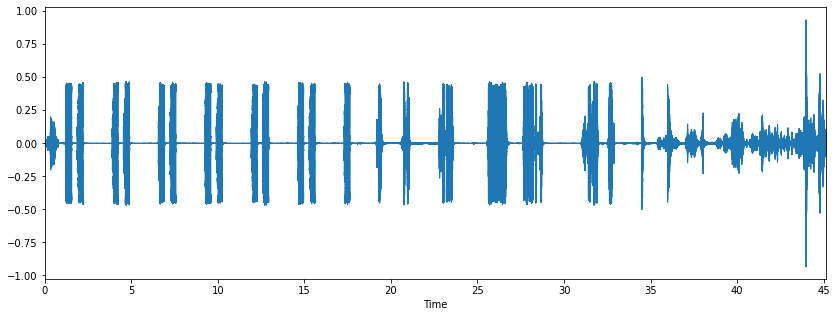

In [76]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(y, sr=sr)

In [77]:
len(y)

1990674

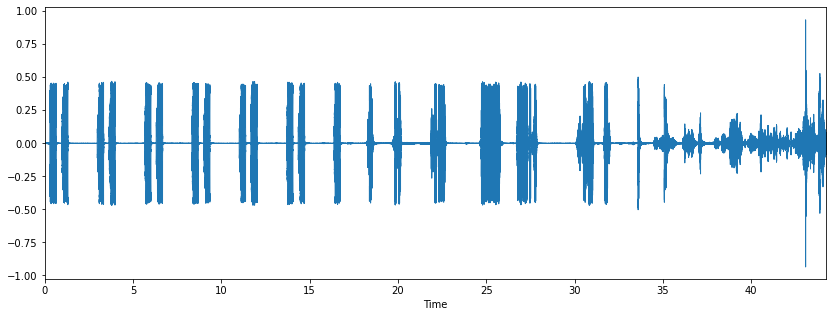

In [78]:
Y = y[40000:,]

plt.figure(figsize=(14, 5))
librosa.display.waveplot(Y, sr=sr)

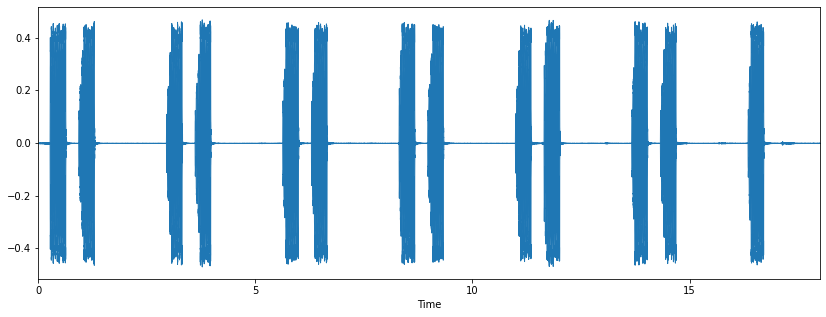

In [79]:
# Y[:793800,]  ==> Tring start to Tring end
plt.figure(figsize=(14, 5))
librosa.display.waveplot(Y[:793800,], sr=sr)

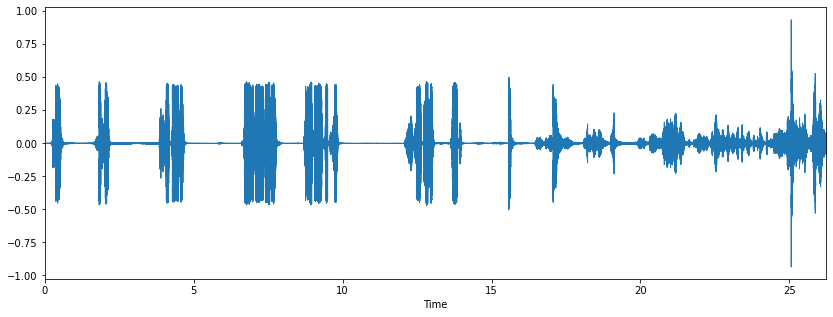

In [80]:
# Y[793800:,] ==> Talk start to Talk end
plt.figure(figsize=(14, 5))
librosa.display.waveplot(Y[793800:,], sr=sr)

## Only Talk -- 0

In [146]:
print(keras_model.predict_classes(scale_features([extract_features(Y[793800:,], 44100)])))
print(random_forest_model.predict(scale_features([extract_features(Y[793800:,], 44100)])))
print(dt_model.predict(scale_features([extract_features(Y[793800:,], 44100)])))

[0]
[0]
[0]


## Only Tring -- 1

In [147]:
print(keras_model.predict_classes(scale_features([extract_features(Y[:793800,], 44100)])))
print(random_forest_model.predict(scale_features([extract_features(Y[:793800,], 44100)])))
print(dt_model.predict(scale_features([extract_features(Y[:793800,], 44100)])))

[1]
[0]
[1]


In [104]:
test_audio = 'test_audio2.mp3'
y , sr = librosa.load(test_audio, sr=44100)
ipd.Audio(test_audio)

/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


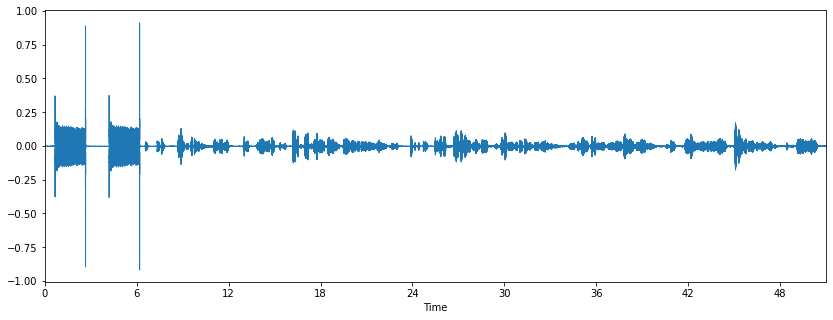

In [107]:
# Y = y[40000:,]

plt.figure(figsize=(14, 5))
librosa.display.waveplot(y[1058400:3307500,], sr=sr)

In [108]:
librosa.output.write_wav('test_audio2.wav',y[1058400:3307500,], sr=44100)

In [144]:
test_audio = 'test_audio2.wav'
y , sr = librosa.load(test_audio, sr=44100)
ipd.Audio(test_audio)

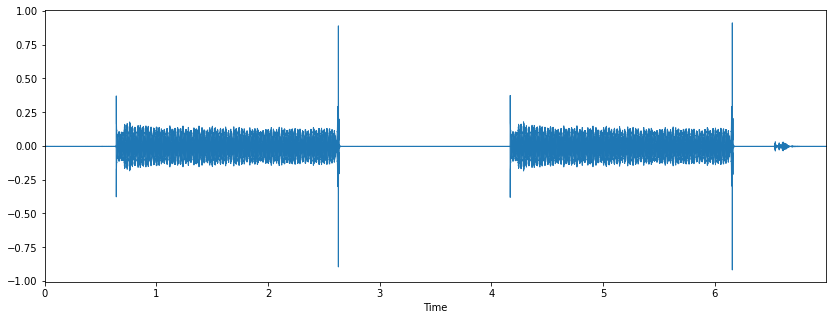

In [113]:
# Y = y[40000:,]

plt.figure(figsize=(14, 5))
librosa.display.waveplot(y[:7*sr,], sr=sr)

In [145]:
#y[:7*sr,]
print(keras_model.predict_classes(scale_features([extract_features(y[:7*sr,], 44100)])))
print(random_forest_model.predict(scale_features([extract_features(y[:7*sr,], 44100)])))
print(dt_model.predict(scale_features([extract_features(y[:7*sr,], 44100)])))

[1]
[0]
[1]


In [148]:
#y[:7*sr,]
print(keras_model.predict_classes(scale_features([extract_features(y[7*sr:,], 44100)])))
print(random_forest_model.predict(scale_features([extract_features(y[7*sr:,], 44100)])))
print(dt_model.predict(scale_features([extract_features(y[7*sr:,], 44100)])))

[0]
[0]
[0]


# Reading and prediction with 1 second frame

In [176]:
test_audio = 'test_audio.mp4'
y , sr = librosa.load(test_audio, sr=44100)
ipd.Audio(test_audio)

/Users/mayank.gupta/venv/audio/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


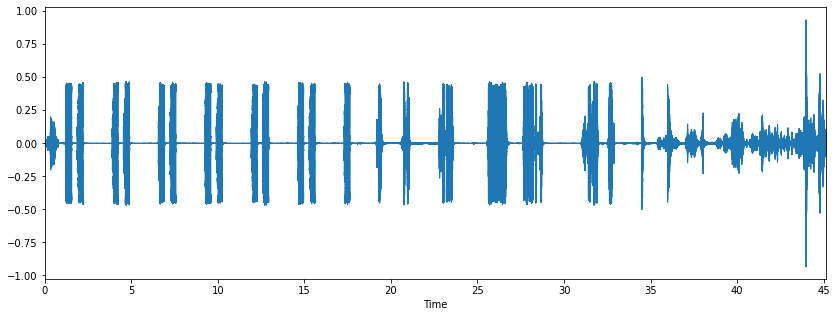

In [177]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(y, sr=sr)

In [178]:
minus_i = 0
for i in range(44100,len(y[:40*sr,]), 44100):
    print(f'{minus_i/44100} to {i/44100}:', keras_model.predict_classes(scale_features([extract_features(y[minus_i:i,], 44100)])))
    minus_i = i

0.0 to 1.0: [0]
1.0 to 2.0: [0]
2.0 to 3.0: [1]
3.0 to 4.0: [1]
4.0 to 5.0: [0]
5.0 to 6.0: [0]
6.0 to 7.0: [0]
7.0 to 8.0: [0]
8.0 to 9.0: [0]
9.0 to 10.0: [0]
10.0 to 11.0: [1]
11.0 to 12.0: [1]
12.0 to 13.0: [0]
13.0 to 14.0: [1]
14.0 to 15.0: [0]
15.0 to 16.0: [0]
16.0 to 17.0: [0]
17.0 to 18.0: [0]
18.0 to 19.0: [0]
19.0 to 20.0: [0]
20.0 to 21.0: [0]
21.0 to 22.0: [0]
22.0 to 23.0: [0]
23.0 to 24.0: [0]
24.0 to 25.0: [0]
25.0 to 26.0: [0]
26.0 to 27.0: [0]
27.0 to 28.0: [0]
28.0 to 29.0: [0]
29.0 to 30.0: [0]
30.0 to 31.0: [1]
31.0 to 32.0: [0]
32.0 to 33.0: [0]
33.0 to 34.0: [1]
34.0 to 35.0: [1]
35.0 to 36.0: [0]
36.0 to 37.0: [0]
37.0 to 38.0: [0]
38.0 to 39.0: [0]


In [155]:
librosa.feature.temp

[1]
